In [9]:
import tensorflow as tf
import os
import matplotlib.pyplot as plt
import cv2

In [ ]:
import os
import zipfile
local_zip = '/tmp/horse-or-human.zip'
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('/tmp/horse-or-human')
local_zip = '/tmp/validation-horse-or-human.zip'
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('/tmp/validation-horse-or-human')
zip_ref.close()

In [2]:
# Directory with our training horse pictures
train_horse_dir = os.path.join('/home/mazz/Desktop/github/tmp/horse-or-human/horses')

# Directory with our training human pictures
train_human_dir = os.path.join('/home/mazz/Desktop/github/tmp/horse-or-human/humans')

In [4]:
train_horse_names = os.listdir(train_horse_dir)
print(train_horse_names[:10])

train_human_names = os.listdir(train_human_dir)
print(train_human_names[:10])

['horse49-9.png', 'horse08-1.png', 'horse26-2.png', 'horse22-1.png', 'horse49-6.png', 'horse41-7.png', 'horse35-6.png', 'horse22-6.png', 'horse23-8.png', 'horse45-2.png']
['human05-10.png', 'human14-01.png', 'human01-11.png', 'human07-19.png', 'human08-16.png', 'human12-15.png', 'human13-22.png', 'human13-07.png', 'human17-16.png', 'human08-29.png']


In [5]:
print('total training horse images:', len(os.listdir(train_horse_dir)))
print('total training human images:', len(os.listdir(train_human_dir)))

total training horse images: 500
total training human images: 527


In [33]:
%matplotlib inline

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Parameters for our graph; we'll output images in a 4x4 configuration
nrows = 10
ncols = 10
# Index for iterating over images

10


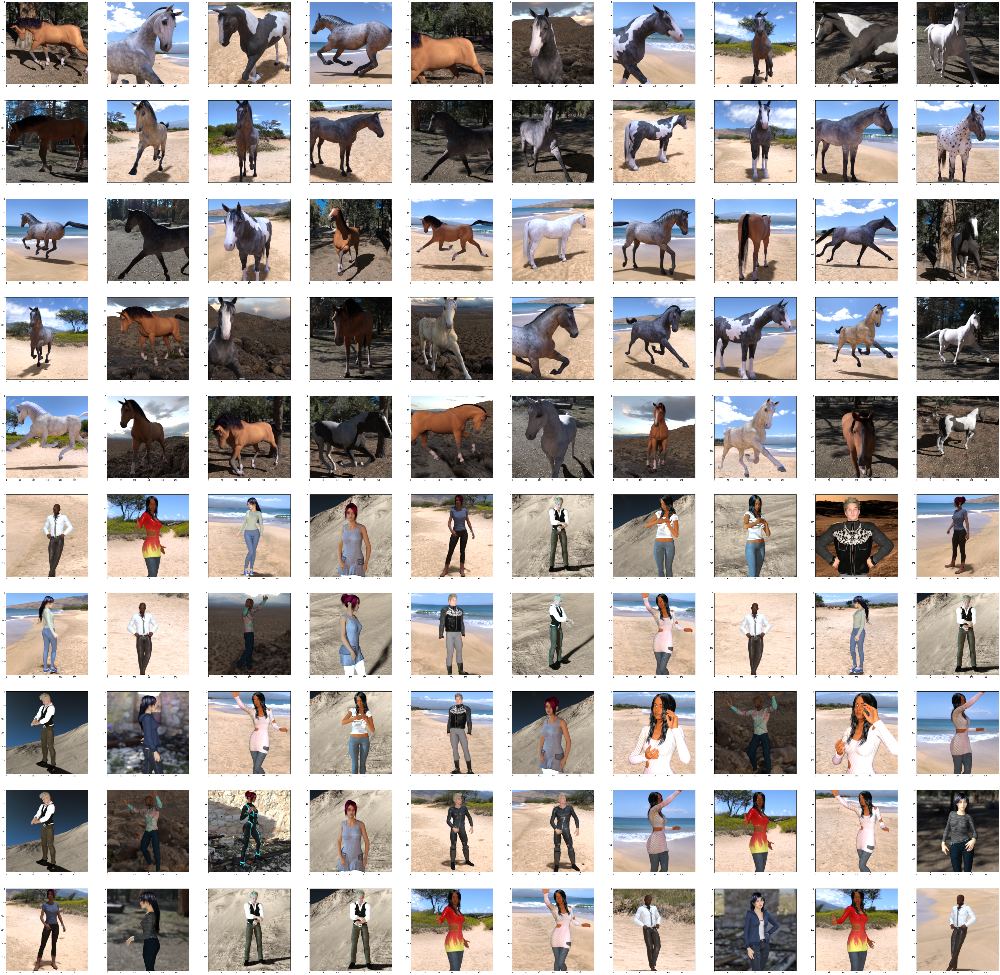

In [34]:
pic_index=0
pic_index+=10
print(pic_index)
fig =plt.gcf()
fig.set_size_inches(nrows*pic_index,ncols*pic_index)
next_horse_pics = [ os.path.join(train_horse_dir, horse_name) for horse_name in train_horse_names[:(nrows*pic_index)//2]]
next_human_pics = [ os.path.join(train_human_dir, human_name) for human_name in train_human_names[:(ncols*pic_index)//2]]
# print(len(next_horse_pics+next_human_pics))
for ind,pic in enumerate(next_horse_pics+next_human_pics):
#     print(ind+1)
    sp = plt.subplot(nrows,ncols,ind+1)
    img = cv2.imread(pic)
    plt.imshow(img[:,:,::-1])
plt.show()

In [35]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator


In [37]:
train_datagen = ImageDataGenerator(rescale=1/255)
train_generator=train_datagen.flow_from_directory("/home/mazz/Desktop/github/tmp/horse-or-human",target_size=(300,300),batch_size=128,class_mode='binary')

Found 1027 images belonging to 2 classes.


In [ ]:
history = model.fit(train_generator,steps_per_epoch=8,epochs=15,verbose=1)
